# California Motor Vehicle Accidents - A Closer Look - March 2016 to December 2019 

The following is a *working-in-progress* analysis on motor vehicle accidents recorded in California from March 2016 to December 2019. 

The goal of this study is to have a fun exploratory walk through the dataset, where along the way we may:
* identify the costs and severity of accidents
* discover what contributing factors may impact a traffic accident
* get acquainted to where accidents occur
* discuss what roadway technologies we can implement
* address where these resources can be allocated as to address the most motorist or a sub-category of motorists

Data is available from https://bit.ly/3dO7Kiy and was originally retrieved from the MapQuest, Bing, among other traffic incident APIs. GeoJSON data was accessed from https://bit.ly/2BU6Nbj, with data made possible by the United States Census Bureau. Both datasets were filtered down to capture soley California traffic data and the code associated with the filters are in the accompanying Jupyter Notebooks.

**Important Note:** This notebook is best viewed in a Jupyter Notebook environment. Due to the way that Github renders javascript , the Folium maps below are not visible natively on Github. Access the full dynamic file at Jupyter nbviewer here: https://bit.ly/2NKkUlV

## Pre-Processing

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import folium
import os
import seaborn as sns
from folium import plugins
from folium.plugins import HeatMap
import calendar
from math import radians, sin, cos, atan2, sqrt

#### Haversine Formula:
Takes two sets of latitude and longitude coordiantes and computes the distance between them. 

In [2]:
def distanceBetween(lat1, lon1, lat2, lon2):
    R = 6371 # mean radius of earth
    
    Sig1 = radians(lat1)
    Sig2 = radians(lat2)
    DeltaSig = radians(lat2-lat1)
    DeltaLamb = radians(lon2-lon1)
    
    a = (sin(DeltaSig/2) ** 2) + cos(Sig1) * cos(Sig2) * (sin(DeltaLamb/2) ** 2)
    c = 2 * atan2(sqrt(a), sqrt(1-a))
    d = R * c

    return d

In [3]:
pd.set_option('display.max_columns', None)

In [4]:
# path to California GeoJSON data
counties_path = os.path.join('data', 'CA-counties.json')

In [5]:
CA_path = os.path.join('data', 'CA-Traffic-Accidents-Feb16-Dec19.csv')
df = pd.read_csv(CA_path)
# convert to datetime format
df['Start_Time'] = pd.to_datetime(df['Start_Time'])
df['End_Time'] = pd.to_datetime(df['End_Time'])
df.head()

,Unnamed: 0,ID,Source,TMC,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Description,Number,Street,Side,City,County,State,Zipcode,Country,Timezone,Airport_Code,Weather_Timestamp,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Direction,Wind_Speed(mph),Precipitation(in),Weather_Condition,Amenity,Bump,Crossing,Give_Way,Junction,No_Exit,Railway,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
0,728,A-729,MapQuest,201.0,3,2016-06-21 10:34:40,2016-06-21 11:04:40,38.085300,-122.233017,NaN,NaN,0.0,Right hand shoulder blocked due to accident on...,NaN,Magazine St,R,Vallejo,Solano,CA,94591,US,US/Pacific,KAPC,2016-06-21 10:54:00,75.0,NaN,48.0,30.00,10.0,Variable,5.8,NaN,Clear,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day
1,729,A-730,MapQuest,201.0,3,2016-06-21 10:30:16,2016-06-21 11:16:39,37.631813,-122.084167,NaN,NaN,0.0,Accident on I-880 Northbound at Exit 26 Tennys...,NaN,I-880 N,R,Hayward,Alameda,CA,94544,US,US/Pacific,KHWD,2016-06-21 10:54:00,75.0,NaN,48.0,30.06,10.0,WSW,4.6,NaN,Clear,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day
2,730,A-731,MapQuest,201.0,2,2016-06-21 10:49:14,2016-06-21 11:19:14,37.896564,-122.070717,NaN,NaN,0.0,Right lane blocked due to accident on CA-24 We...,NaN,I-680 N,R,Walnut Creek,Contra Costa,CA,94595,US,US/Pacific,KCCR,2016-06-21 10:53:00,82.9,NaN,31.0,29.97,10.0,NNW,4.6,NaN,Clear,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day
3,731,A-732,MapQuest,201.0,3,2016-06-21 10:41:42,2016-06-21 11:11:42,37.334255,-122.032471,NaN,NaN,0.0,#4 &amp; HOV lane blocked due to accident on I...,NaN,N De Anza Blvd,R,Cupertino,Santa Clara,CA,95014,US,US/Pacific,KNUQ,2016-06-21 10:56:00,75.9,NaN,48.0,30.04,10.0,NNE,4.6,NaN,Clear,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day
4,732,A-733,MapQuest,201.0,2,2016-06-21 10:16:26,2016-06-21 11:04:16,37.250729,-121.910713,NaN,NaN,0.0,Right hand shoulder blocked due to accident on...,NaN,Norman Y Mineta Hwy,R,San Jose,Santa Clara,CA,95118,US,US/Pacific,KRHV,2016-06-21 09:50:00,75.2,NaN,41.0,30.06,10.0,Variable,5.8,NaN,Clear,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day


In [6]:
df.insert(7, 'Time_Difference', df['End_Time'] - df['Start_Time'])

In [7]:
df.insert(8, 'Minute_Difference', df['Time_Difference'].astype('timedelta64[m]'))

In [8]:
df

,Unnamed: 0,ID,Source,TMC,Severity,Start_Time,End_Time,Time_Difference,Minute_Difference,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Description,Number,Street,Side,City,County,State,Zipcode,Country,Timezone,Airport_Code,Weather_Timestamp,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Direction,Wind_Speed(mph),Precipitation(in),Weather_Condition,Amenity,Bump,Crossing,Give_Way,Junction,No_Exit,Railway,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
0,728,A-729,MapQuest,201.0,3,2016-06-21 10:34:40,2016-06-21 11:04:40,00:30:00,30.0,38.085300,-122.233017,NaN,NaN,0.000,Right hand shoulder blocked due to accident on...,NaN,Magazine St,R,Vallejo,Solano,CA,94591,US,US/Pacific,KAPC,2016-06-21 10:54:00,75.0,NaN,48.0,30.00,10.0,Variable,5.8,NaN,Clear,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day
1,729,A-730,MapQuest,201.0,3,2016-06-21 10:30:16,2016-06-21 11:16:39,00:46:23,46.0,37.631813,-122.084167,NaN,NaN,0.000,Accident on I-880 Northbound at Exit 26 Tennys...,NaN,I-880 N,R,Hayward,Alameda,CA,94544,US,US/Pacific,KHWD,2016-06-21 10:54:00,75.0,NaN,48.0,30.06,10.0,WSW,4.6,NaN,Clear,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day
2,730,A-731,MapQuest,201.0,2,2016-06-21 10:49:14,2016-06-21 11:19:14,00:30:00,30.0,37.896564,-122.070717,NaN,NaN,0.000,Right lane blocked due to accident on CA-24 We...,NaN,I-680 N,R,Walnut Creek,Contra Costa,CA,94595,US,US/Pacific,KCCR,2016-06-21 10:53:00,82.9,NaN,31.0,29.97,10.0,NNW,4.6,NaN,Clear,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day
3,731,A-732,MapQuest,201.0,3,2016-06-21 10:41:42,2016-06-21 11:11:42,00:30:00,30.0,37.334255,-122.032471,NaN,NaN,0.000,#4 &amp; HOV lane blocked due to accident on I...,NaN,N De Anza Blvd,R,Cupertino,Santa Clara,CA,95014,US,US/Pacific,KNUQ,2016-06-21 10:56:00,75.9,NaN,48.0,30.04,10.0,NNE,4.6,NaN,Clear,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day
4,732,A-733,MapQuest,201.0,2,2016-06-21 10:16:26,2016-06-21 11:04:16,00:47:50,47.0,37.250729,-121.910713,NaN,NaN,0.000,Right hand shoulder blocked due to accident on...,NaN,Norman Y Mineta Hwy,R,San Jose,Santa Clara,CA,95118,US,US/Pacific,KRHV,2016-06-21 09:50:00,75.2,NaN,41.0,30.06,10.0,Variable,5.8,NaN,Clear,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
663199,2974330,A-2974354,Bing,NaN,2,2019-08-23 18:03:25,2019-08-23 18:32:01,00:28:36,28.0,34.002480,-117.379360,33.99888,-117.37094,0.543,At Market St - Accident.,NaN,Pomona Fwy E,R,Riverside,Riverside,CA,92501,US,US/Pacific,KRAL,2019-08-23 17:53:00,86.0,86.0,40.0,28.92,10.0,W,13.0,0.0,Fair,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day
663200,2974331,A-2974355,Bing,NaN,2,2019-08-23 19:11:30,2019-08-23 19:38:23,00:26:53,26.0,32.766960,-117.148060,32.76555,-117.15363,0.338,At Camino Del Rio/Mission Center Rd - Accident.,NaN,I-8 W,R,San Diego,San Diego,CA,92108,US,US/Pacific,KMYF,2019-08-23 18:53:00,70.0,70.0,73.0,29.39,10.0,SW,6.0,0.0,Fair,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day
663201,2974332,A-2974356,Bing,NaN,2,2019-08-23 19:00:21,2019-08-23 19:28:49,00:28:28,28.0,33.775450,-117.847790,33.77740,-117.85727,0.561,At Glassell St/Grand Ave - Accident. in the ri...,NaN,Garden Grove Fwy,R,Orange,Orange,CA,92866,US,US/Pacific,KSNA,2019-08-23 18:53:00,73.0,73.0,64.0,29.74,10.0,SSW,10.0,0.0,Partly Cloudy,False,False,False,False,True,False,False,False,False,False,False,False,False,Day,Day,Day,Day
663202,2974333,A-2974357,Bing,NaN,2

## What is the time cost associated with being involved in a Traffic Accident?

In [9]:
# copy the primary dataframe into a Time Change or TC df
df_TC = df

In [10]:
# drop values that possess negative durations
df_TC.drop(df_TC[df_TC['Minute_Difference'] < 0].index, inplace=True)

In [11]:
# top 10 most common durations for a traffic accident
accidentDurationPct = df_TC['Minute_Difference'].value_counts(normalize=True).nlargest(10)
accidentDurationPct

29.0     0.317614
44.0     0.148770
360.0    0.131235
45.0     0.041159
30.0     0.036944
59.0     0.022147
60.0     0.020311
28.0     0.018409
32.0     0.013447
74.0     0.012241
Name: Minute_Difference, dtype: float64

In [12]:
topTenDurationPct = accidentDurationPct.sum()
print(f'The top 10 most common durations for a traffic accident make up {round(topTenDurationPct, 2) * 100}% of recorded accident durations')

The top 10 most common durations for a traffic accident make up 76.0% of recorded accident durations


In [13]:
df_TC['Minute_Difference'].agg(['mean', 'median'])

mean      94.394903
median    44.000000
Name: Minute_Difference, dtype: float64

The median duration for a California Traffic Accident is 44 minutes.

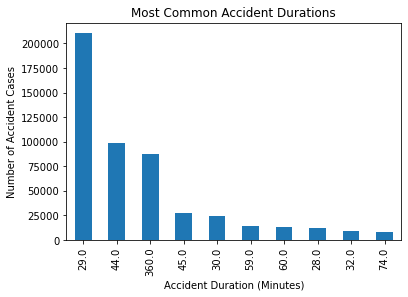

In [14]:
topAccidentDuration = df_TC['Minute_Difference'].value_counts().nlargest(10)
topAccidentDuration.plot(kind='bar')
plt.ylabel('Number of Accident Cases')
plt.xlabel('Accident Duration (Minutes)')
plt.title('Most Common Accident Durations')
plt.show()

Given that 76.0% of the most common traffic accident durations were encapsuled by the the above time brackets, I was inquisitive whether or not in-between data existed spanning the most common timestamps. It could be very possible that data was rounded into pre-determined duration categories. Thus, I have included a histogram of the recorded durations in minutes and scaled this histogram logarithmically so we can better see less common durations values. From the histogram shown below, we can confirm that in-between data was in fact recorded though I still suspect that categorization was at play for the 29 minute, 44 minute, and 6 hour time groups, since these values appear to be easy to log and work with for police records. Of the top ten most common durations, eight are at or a minute below a time value divisible by the quarter hour.

In [15]:
df_MD = df_TC[df_TC['Minute_Difference'] <= 720].copy()

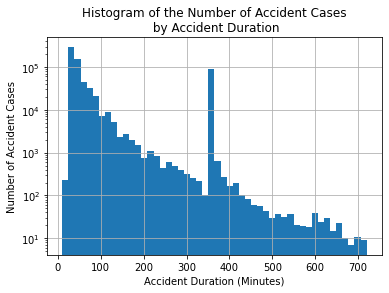

In [16]:
df_MD['Minute_Difference'].hist(bins=50, log=True)
plt.ylabel('Number of Accident Cases')
plt.xlabel('Accident Duration (Minutes)')
plt.title('Histogram of the Number of Accident Cases\n by Accident Duration')
plt.show()

In [17]:
df_TC[df_TC['Time_Difference'].apply(lambda x: x.days) > 7].head()

,Unnamed: 0,ID,Source,TMC,Severity,Start_Time,End_Time,Time_Difference,Minute_Difference,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Description,Number,Street,Side,City,County,State,Zipcode,Country,Timezone,Airport_Code,Weather_Timestamp,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Direction,Wind_Speed(mph),Precipitation(in),Weather_Condition,Amenity,Bump,Crossing,Give_Way,Junction,No_Exit,Railway,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
452795,2250778,A-2250802,Bing,NaN,2,2016-06-01 13:13:13,2016-08-31 23:59:00,91 days 10:45:47,131685.0,38.37681,-122.20238,38.44554,-122.19644,4.760,Between Wooden Valley Rd and CA-128/Capell Val...,1001.0,Wooden Valley Rd,R,Napa,Napa,CA,94558-9616,US,US/Pacific,KAPC,2016-06-01 12:54:00,70.0,NaN,59.0,29.87,10.0,South,10.4,NaN,Clear,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day
452796,2250779,A-2250803,Bing,NaN,2,2016-06-01 13:13:13,2016-08-31 23:59:00,91 days 10:45:47,131685.0,38.44554,-122.19644,38.37681,-122.20238,4.760,Between CA-128/Capell Valley Rd and Wooden Val...,1001.0,Capell Valley Rd,L,Napa,Napa,CA,94558-9639,US,US/Pacific,KAPC,2016-06-01 12:54:00,70.0,NaN,59.0,29.87,10.0,South,10.4,NaN,Clear,False,False,False,False,False,False,False,False,False,False,False,False,False,Day,Day,Day,Day
454453,2252437,A-2252461,Bing,NaN,4,2016-04-04 19:03:16,2017-06-17 05:00:00,438 days 09:56:44,631316.0,33.79237,-118.22474,33.78318,-118.22676,0.645,Closed between Willow St and I St - Road close...,NaN,Terminal Island Fwy S,R,Long Beach,Los Angeles,CA,90810,US,US/Pacific,KLGB,2016-04-04 18:53:00,70.0,NaN,47.0,30.04,10.0,NW,9.2,NaN,Clear,False,False,False,False,True,False,False,False,False,False,False,False,False,Day,Day,Day,Day
456663,2254647,A-2254671,Bing,NaN,4,2016-05-06 11:55:01,2016-05-31 23:59:00,25 days 12:03:59,36723.0,34.49816,-117.73836,34.49896,-117.66005,4.460,Closed between CA-138/Antelope Hwy and 263rd S...,NaN,Pearblossom Hwy,R,Llano,Los Angeles,CA,93544,US,US/Pacific,KGXA,2016-05-06 13:45:00,62.6,NaN,39.0,29.83,10.0,WSW,13.8,NaN,Scattered Clouds,False,False,False,False,False,False,False,False,False,True,False,False,False,Day,Day,Day,Day
480274,2381566,A-2381590,Bing,NaN,2,2016-08-22 02:50:32,2016-08-31 23:59:00,9 days 21:08:28,14228.0,38.44554,-122.19644,38.37681,-122.20238,4.760,Between CA-128/Capell Valley Rd and Wooden Val...,1001.0,Capell Valley Rd,L,Napa,Napa,CA,94558-9639,US,US/Pacific,KAPC,2016-08-22 02:49:00,55.4,NaN,94.0,29.91,10.0,West,12.7,NaN,Scattered Clouds,False,False,False,False,False,False,False,False,False,False,False,False,False,Night,Night,Night,Night


#### Outlier Data

In [18]:
casesOverTwelve = df[df['Minute_Difference'] > 720].shape[0]
negativeCases = df[df['Minute_Difference'] < 0].shape[0]
totalCases = df.shape[0]
print(f'The number of cases over twelve hours is {casesOverTwelve}. The number of cases that have negative durations is {negativeCases}.')

The number of cases over twelve hours is 267. The number of cases that have negative durations is 0.


I will be discrediting the cases that appear to have negative durations for the sake of time sensitive data. Additionally, I will hold less weight for cases over twelve hours and espcially for cases over 7 days, since they are in the statistical minority. Some values in this camp have accident durations lasting well over 100 days, with one data point suggesting an accident lasted a whopping 438 days. It is possible that factors such as vehicle repair, insurance claims, and potential court action are accounted for in this timeline.

## What is the median distance spanning between the beginning and end of an accident?

In [19]:
distance_between = df.apply(lambda x: distanceBetween(x['Start_Lat'], x['Start_Lng'], x['End_Lat'], x['End_Lng']), axis=1)
df.insert(13, 'distance_between', distance_between)

In [20]:
df['distance_between']

0              NaN
1              NaN
2              NaN
3              NaN
4              NaN
            ...   
663199    0.873334
663200    0.543895
663201    0.902635
663202    1.242030
663203    0.863724
Name: distance_between, Length: 663191, dtype: float64

In [21]:
distance_between.dropna(inplace=True)

In [22]:
(distance_between < 0).value_counts()

False    213906
dtype: int64

In [23]:
(distance_between > 10).value_counts()

False    213480
True        426
dtype: int64

In [24]:
distance_between.describe()

count    213906.000000
mean          0.467482
std           1.286345
min           0.000000
25%           0.000000
50%           0.061540
75%           0.704807
max         221.474483
dtype: float64

In [25]:
distance_between.median()

0.06153998646518022

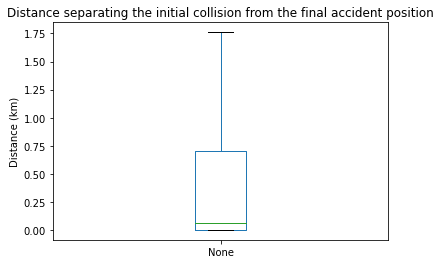

In [26]:
distance_between.plot.box(showfliers=False)
plt.title('Distance separating the initial collision from the final accident position')
plt.ylabel('Distance (km)')
plt.xlabel('')
plt.show()

## Which counties experience the most accidents?

In [27]:
# percentage of total accidents by county
df['County'].value_counts(normalize=True).nlargest(5)

Los Angeles    0.342548
Alameda        0.068404
Orange         0.063822
San Diego      0.063072
Sacramento     0.053974
Name: County, dtype: float64

In [28]:
cp_df = pd.DataFrame()
cp_df['Accidents'] = df['County'].value_counts()
cp_df.insert(0, 'County', df['County'].value_counts().index)
cp_df.index = range(len(cp_df['County']))
cp_df.head()

,County,Accidents
0,Los Angeles,227175
1,Alameda,45365
2,Orange,42326
3,San Diego,41829
4,Sacramento,35795


In [29]:
mc = folium.Map(location=[36.778259, -119.417931], zoom_start=5)

folium.Choropleth(
    geo_data=counties_path,
    name = 'choropleth',
    data = cp_df,
    columns = list(cp_df.columns),
    key_on = 'feature.properties.NAME',
    fill_Color='YLGn',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name = 'Accidents by County from March 2016 to December 2019'
    ).add_to(mc)

folium.LayerControl().add_to(mc)

mc

## Over the 4 year period, where do accidents take place in California?

In [30]:
# list of (year, month) tuples 
df.insert(5, 'Year_Month', df['Start_Time'].apply(lambda x: (x.year, x.month)))

In [31]:
def getYMtuples(filtered_df):
    year_month = filtered_df['Year_Month'].value_counts().sort_index()
    year_month_list = list(year_month.index)
    
    return year_month_list

# get a sorted list of tuples (e.g. '(2016, 3) to (2019, 12)')

In [32]:
def heatMapIt(filtered_df, timeIndex, static):
    # dataframe must be pre-filtered before calling heatMapIt()
    # time index is in the tuple form of (year, month)
    # static refers to whether or not a static or time series heatmap will be returned
    
    m = folium.Map(location=[36.778259, -119.417931], zoom_start=5)
    
    heatMap_df = filtered_df[['Start_Lat', 'Start_Lng']].copy()
    # We know Lat and Lng are both float so we don't need to convert
        
    heatMap_df = heatMap_df.dropna(axis=0, subset=['Start_Lat', 'Start_Lng'])
    # We know Start Lat and Lng in this df do not have NaN values, but for future-proofing we drop NaN values
    
    if static:
        heatMap_list = [[row['Start_Lat'], row['Start_Lng']] for index, row in heatMap_df.iterrows()]
        HeatMap(heatMap_list).add_to(m)
    
    else:
        # list of years followed by month name (e.g. '2016 March' to '2019 December')
        timeIndexHeatMap = [str(tI[0]) + ' ' + calendar.month_name[tI[1]] for tI in timeIndex]

        heatMap_df['Time'] = filtered_df['Year_Month']

        heatMap_df = heatMap_df.dropna(axis=0, subset=['Time'])
        # drop NaN values for Time

        heatMap_list = [
            [[row['Start_Lat'], row['Start_Lng']]
                          for index, row in heatMap_df[heatMap_df['Time'] == timeIndex[i]].iterrows()]
            for i in range(len(timeIndex))]
        # Folium's heatMap() takes a list of lists containing the desired coordinates
        # df.iterrows() returns an iterable that can be unpacked as an index and the series data for that row
        # By specifying the index for that series (e.g. 'Start_Lat') we can get the latitude value for that row

        vm = plugins.HeatMapWithTime(heatMap_list, index=timeIndexHeatMap, auto_play=True, max_opacity=0.8)
        vm.add_to(m)

    return m

### Vanilla Accident HeatMap by year, month period

In [33]:
general_YM = getYMtuples(df)
# NOTE: that the general_YM list of year month values contains all of the year, month combinations
# present in the unfiltered dataframe. Different year, month values should be generated using
# the getYMtuples() function when working with very narrow filtered dataframes

In [34]:
heatMapIt(df, general_YM, static=False)

### Filterable Accident HeatMap by year, month period
By altering the filters below, we can identify accident hotspots present in the data.

In [35]:
filt = (df['Street'] == 'I-5 N' ) & (df['Start_Time'] > '2019')
heatMapIt(df.loc[filt], getYMtuples(df.loc[filt]), static=True)

#### Most Accident prone streets
Unsurprisingly most of the most accident prone street are the iterstate highways.

In [36]:
df['Street'].value_counts().nlargest(10)

I-5 N              20004
I-10 E             14423
I-405 N            14419
US-101 N           13406
I-10 W             12458
San Diego Fwy S    11953
I-80 W             10822
I-80 E              9473
I-580 W             7198
I-5 S               7189
Name: Street, dtype: int64

# References:

* Moosavi, Sobhan. “US Accidents (3.0 Million Records).” Kaggle, 17 Jan. 2020, www.kaggle.com/sobhanmoosavi/us-accidents.
* Moosavi, Sobhan, Mohammad Hossein Samavatian, Srinivasan Parthasarathy, and Rajiv Ramnath. “A Countrywide Traffic Accident Dataset.”, 2019.
* Moosavi, Sobhan, Mohammad Hossein Samavatian, Srinivasan Parthasarathy, Radu Teodorescu, and Rajiv Ramnath. "Accident Risk Prediction based on Heterogeneous Sparse Data: New Dataset and Insights." In proceedings of the 27th ACM SIGSPATIAL International Conference on Advances in Geographic Information Systems, ACM, 2019.
* “GeoJSON and KML Data for the United States.” Eric Celeste, eric.clst.org/tech/usgeojson/.
* Chris Veness, www.movable-type.co.uk. “Movable Type Scripts.” Calculate Distance and Bearing between Two Latitude/Longitude Points Using Haversine Formula in JavaScript, www.movable-type.co.uk/scripts/latlong.html.
